<h1><b>Assignment 1 - ML Data Cleaning and Feature Selection<b></h1>

# **Dataset description**

**Dataset** - [NIFTY 50 Dataset 2000 - 2021](https://www.kaggle.com/datasets/rohanrao/nifty50-stock-market-data)

**Context**

The data is the price history and trading volumes of the fifty stocks in the index NIFTY 50 from NSE (National Stock Exchange) India. All datasets are at a day-level with pricing and trading values split across .cvs files for each stock along with a metadata file with some macro-information about the stocks itself. The data in the dataset spans from 1st January, 2000 to 30th April, 2021.


**Metadata**

Date - Trade Data: Represents the date of the trading data, indicating when the stock market activity occurred.

Symbol - Name of Stock: Refers to the unique code or symbol assigned to a particular stock. It is essentially the shorthand representation of the company's name on the stock exchange.

Series - Type of Security: Specifies the type of security, which could include different classes of financial instruments such as equity shares, preference shares, or other financial products.

Prev Close - Previous Day's Closing Price: Indicates the closing price of the stock on the previous trading day.

Open - Opening Price for the Day: Represents the initial price at which a stock is traded on a given day.

High - Highest Price for the Day: Denotes the highest trading price reached by the stock during the trading day.

Low - Lowest Price for the Day: Represents the lowest trading price reached by the stock during the trading day.

Last - Last Trade Price: Refers to the price at which the last trade was executed.

Close - Closing Price: Indicates the final trading price of the stock at the end of the trading day.

VWAP - Volume-Weighted Average Price: VWAP is a ratio of the cumulative share price to the cumulative volume traded over a given time period. It provides insight into the average price at which a stock is traded, weighted by the volume of trades.

Volume - Volume Traded for the Day: Represents the total number of shares or contracts traded during a specific time period, typically a trading day.

Turnover - Turnover Ratio: The turnover ratio is the ratio of sellers to buyers of a stock. It helps in understanding the market activity and liquidity.

Trades - Number of Trades: Indicates the total number of trades (buy and sell transactions) that occurred during the trading day.

Deliverable Volume - Amount of Deliverable Volume: Represents the volume of shares that were actually delivered (transferred) as opposed to being traded intraday.

% Deliverable - Percentage of Deliverable Shares: Indicates the percentage of shares that were delivered out of the total traded volume.

Note: All the prices are denoted in Indian Rupees (INR), as mentioned at the end of the description. This dataset provides comprehensive information about the trading activity of various stocks, allowing users to analyze and understand the market trends and stock behavior.

***The project aims to answer below questions:***
* What are the data types? (Only numeric and categorical)

* Are there missing values?

* What are the likely distributions of the numeric variables?

* Which independent variables are useful to predict a target (dependent variable)? (Use at least three methods)

* Which independent variables have missing data? How much?

* Do the training and test sets have the same data?

* In the predictor variables independent of all the other predictor variables?

* Which predictor variables are the most important?

* Do the ranges of the predictor variables make sense?

* What are the distributions of the predictor variables?   

* Remove outliers and keep outliers (does if have an effect of the final predictive model)?

* Remove 1%, 5%, and 10% of your data randomly and impute the values back using at least 3 imputation methods. How well did the methods recover the missing values?  That is remove some data, check the % error on residuals for numeric data and check for bias and variance of the error.

* For categorical data, calculate the accuracy and a confusion matrix.

# <b>Installation of libraries</b>


In [1]:
!pip install pandas

In [2]:
!pip install matplotlib

In [3]:
!pip install plotly

In [4]:
!pip install seaborn

In [5]:
!pip install scipy

# <b>Importing libraries</b>
- **For ML Models**: sklearn, scipy
- **For Data Manipulation**: pandas, sklearn
- **For Data Visualization**: plotly, matplotlib, seaborn

In [6]:
import pandas as pd
import numpy as np
import requests
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.impute import SimpleImputer

import scipy.stats as stats
from scipy.stats import boxcox

#**Reading & Cleaning data**

In [7]:
# Reading data from CSV
# Loading the dataset url
url = "https://raw.githubusercontent.com/Anusha-Gali/DSE_NiftyDataset/main/dataset/NIFTY50_all.csv"

#Request to read the file into the dataframe with response codes fpr validation
response = requests.get(url)
if response.status_code == 200:
  with open('NIFTY50_all.csv','wb') as file:
    file.write(response.content)
    data = pd.read_csv('NIFTY50_all.csv')
else:
  print("Failed to download the file. status_code:", response.status_code)

In [8]:
# Viewing the top 10 data
data.head(10)

,Date,Symbol,Series,Prev Close,Open,High,Low,Last,Close,VWAP,Volume,Turnover,Trades,Deliverable Volume,%Deliverble
0,2007-11-27,MUNDRAPORT,EQ,440.00,770.00,1050.00,770.0,959.00,962.90,984.72,27294366,2.687719e+15,NaN,9859619.0,0.3612
1,2007-11-28,MUNDRAPORT,EQ,962.90,984.00,990.00,874.0,885.00,893.90,941.38,4581338,4.312765e+14,NaN,1453278.0,0.3172
2,2007-11-29,MUNDRAPORT,EQ,893.90,909.00,914.75,841.0,887.00,884.20,888.09,5124121,4.550658e+14,NaN,1069678.0,0.2088
3,2007-11-30,MUNDRAPORT,EQ,884.20,890.00,958.00,890.0,929.00,921.55,929.17,4609762,4.283257e+14,NaN,1260913.0,0.2735
4,2007-12-03,MUNDRAPORT,EQ,921.55,939.75,995.00,922.0,980.00,969.30,965.65,2977470,2.875200e+14,NaN,816123.0,0.2741
5,2007-12-04,MUNDRAPORT,EQ,969.30,985.00,1056.00,976.0,1049.00,1041.45,1015.39,4849250,4.923867e+14,NaN,1537667.0,0.3171
6,2007-12-05,MUNDRAPORT,EQ,1041.45,1061.00,1099.50,1050.0,1084.00,1082.45,1082.79,2848209,3.084010e+14,NaN,904260.0,0.3175
7,2007-12-06,MUNDRAPORT,EQ,1082.45,1089.00,1109.70,1051.0,1090.10,1081.30,1087.03,1749516,1.901771e+14,NaN,825691.0,0.4720
8,2007-12-07,MUNDRAPORT,EQ,1081.30,1100.00,1134.00,1078.0,1100.00,1102.40,1106.57,2247904,2.487465e+14,NaN,697763.0,0.3104
9,2007-12-10,MUNDRAPORT,EQ,1102.40,1110.00,1110.00,1061.1,1073.55,1075.40,1080.38,1012350,1.093727e+14,NaN,417514.0,0.4124


In [9]:
#Viewing the last 10 data
data.tail(10)

,Date,Symbol,Series,Prev Close,Open,High,Low,Last,Close,VWAP,Volume,Turnover,Trades,Deliverable Volume,%Deliverble
235182,2021-04-16,ZEEL,EQ,189.20,189.2,196.90,189.20,196.35,193.95,193.14,7952202,1.535854e+14,52127.0,1962297.0,0.2468
235183,2021-04-19,ZEEL,EQ,193.95,187.0,191.20,185.10,191.00,190.35,188.28,9346956,1.759879e+14,58935.0,1270493.0,0.1359
235184,2021-04-20,ZEEL,EQ,190.35,193.0,201.75,192.20,197.30,197.40,197.17,15709132,3.097437e+14,77021.0,3089894.0,0.1967
235185,2021-04-22,ZEEL,EQ,197.40,195.5,199.80,191.70,192.15,192.30,194.76,10203121,1.987114e+14,70603.0,2930009.0,0.2872
235186,2021-04-23,ZEEL,EQ,192.30,192.0,193.00,187.00,188.00,188.00,190.04,8529439,1.620902e+14,60790.0,2148300.0,0.2519
235187,2021-04-26,ZEEL,EQ,188.00,190.6,191.10,185.10,186.70,186.40,187.35,8542755,1.600451e+14,52374.0,2340188.0,0.2739
235188,2021-04-27,ZEEL,EQ,186.40,188.0,192.95,186.80,188.80,188.15,189.41,14247767,2.698636e+14,73673.0,5425957.0,0.3808
235189,2021-04-28,ZEEL,EQ,188.15,188.8,190.60,187.10,188.95,189.10,188.85,8429439,1.591917e+14,44056.0,2413974.0,0.2864
235190,2021-04-29,ZEEL,EQ,189.10,190.8,191.65,186.00,186.60,186.55,187.44,9483009,1.777471e+14,60932.0,2744472.0,0.2894
235191,2021-04-30,ZEEL,EQ,186.55,185.3,190.95,183.65,185.00,185.60,187.53,11435285,2.144440e+14,62607.0,3323909.0,0.2907


In [10]:
# Viewing the basic statistics
data.describe()

,Prev Close,Open,High,Low,Last,Close,VWAP,Volume,Turnover,Trades,Deliverable Volume,%Deliverble
count,235192.000000,235192.000000,235192.000000,235192.000000,235192.000000,235192.000000,235192.00000,2.351920e+05,2.351920e+05,1.203440e+05,2.191150e+05,219115.000000
mean,1266.196349,1267.759708,1286.581440,1247.488465,1266.388302,1266.554351,1267.13230,3.045903e+06,1.610138e+14,6.196427e+04,1.315098e+06,0.502997
std,2581.370320,2585.259609,2619.649216,2546.621396,2581.392543,2582.140942,2582.69998,7.333981e+06,3.298085e+14,6.866457e+04,2.831670e+06,0.190019
min,0.000000,8.500000,9.750000,8.500000,9.100000,9.150000,9.21000,3.000000e+00,1.047000e+07,1.100000e+01,5.000000e+00,0.023600
25%,274.300000,275.000000,279.500000,269.600000,274.400000,274.350000,274.69750,2.190095e+05,1.612816e+13,2.183400e+04,1.253830e+05,0.364700
50%,566.500000,567.025000,576.900000,556.500000,567.000000,566.700000,566.94000,1.010938e+06,6.832603e+13,4.406800e+04,5.017560e+05,0.511000
75%,1242.200000,1243.312500,1263.000000,1221.650000,1242.900000,1242.400000,1242.66250,3.019851e+06,1.863835e+14,7.893550e+04,1.452233e+06,0.638400
max,32861.950000,33399.950000,33480.000000,32468.100000,32849.000000,32861.950000,32975.24000,4.810589e+08,3.564334e+16,1.643015e+06,2.325307e+08,1.000000


In [11]:
# Converting the 'Symbol' and 'Series' columns to the 'category' data type
data = data.astype({'Symbol': 'category', 'Series': 'category'})

# Converting the 'Date' column to datetime format using pandas to_datetime function
data['Date'] = pd.to_datetime(data['Date'])


# **1. What are the data types? (Only numeric and categorical)**

In [12]:
# Viewing the data types
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 235192 entries, 0 to 235191
Data columns (total 15 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Date                235192 non-null  datetime64[ns]
 1   Symbol              235192 non-null  category      
 2   Series              235192 non-null  category      
 3   Prev Close          235192 non-null  float64       
 4   Open                235192 non-null  float64       
 5   High                235192 non-null  float64       
 6   Low                 235192 non-null  float64       
 7   Last                235192 non-null  float64       
 8   Close               235192 non-null  float64       
 9   VWAP                235192 non-null  float64       
 10  Volume              235192 non-null  int64         
 11  Turnover            235192 non-null  float64       
 12  Trades              120344 non-null  float64       
 13  Deliverable Volume  219115 no

**Conclusion derived**

Dataset has ***1*** datetime data column, ***2*** Categorical data columns and ***12*** numerical data columns.

***DareTime:*** Date

***Categorical data columns:*** Symbol, Series

***Numerical data columns:*** Prev Close, Open, High, Low, Last, Close, VWAP, Volume, Turnover, Trades, Deliverable Volume, %Deliverble

#**2. Are there missing values?**

In [13]:
# Checking for the missing values?
data.isna().sum()

Date                       0
Symbol                     0
Series                     0
Prev Close                 0
Open                       0
High                       0
Low                        0
Last                       0
Close                      0
VWAP                       0
Volume                     0
Turnover                   0
Trades                114848
Deliverable Volume     16077
%Deliverble            16077
dtype: int64

In [14]:
# Filling NaN values of each column
data.fillna(0, inplace=True)

In [15]:
#Rechecking for missing values
data.isna().sum()

Date                  0
Symbol                0
Series                0
Prev Close            0
Open                  0
High                  0
Low                   0
Last                  0
Close                 0
VWAP                  0
Volume                0
Turnover              0
Trades                0
Deliverable Volume    0
%Deliverble           0
dtype: int64

**Conclusion derived**

There are * missing values* in the dataset columns Trades, Deliverable Volume, %Deliverble.Hence, filling the NaN values with zero.

***Reason for filling***

Number of ***Trades*** could be 0, indicating no buying or selling activity. Volumes are always positive representing the number of trades per day for the stock.

***Deliverable Volume*** could also be 0, representing the shares of a stock traded and delivered during a trade.

***%Deliverble*** could also be 0 indicating the possibility that the percentage of shares delivered for a stock on a trading day is zero or close to zero. It measures the proportion of shares traded that were actually delivered to buyers' accounts.

#**Cleaning the data further more**

In [16]:
# Retrieve the unique values in the 'Symbol' column of the DataFrame as I have observed some disperancies in the .csv files
print(data["Symbol"].unique())

['MUNDRAPORT', 'ADANIPORTS', 'ASIANPAINT', 'UTIBANK', 'AXISBANK', ..., 'SSLT', 'VEDL', 'WIPRO', 'ZEETELE', 'ZEEL']
Length: 65
Categories (65, object): ['ADANIPORTS', 'ASIANPAINT', 'AXISBANK', 'BAJAJ-AUTO', ..., 'VEDL', 'WIPRO',
                          'ZEEL', 'ZEETELE']


In [17]:
# Replacing specific values in the 'Symbol' column with corresponding replacements (done by verifying the all the .csv in the Dataset)
replace = [
    ["MUNDRAPORT", "ADANIPORTS"],
    ["UTIBANK", "AXISBANK"],
    ["BAJAUTOFIN", "BAJFINANCE"],
    ["BHARTI", "BHARTIARTL"],
    ["HEROHONDA", "HEROMOTOCO"],
    ["HINDALC0", "HINDALCO"],
    ["HINDLEVER", "HINDUNILVR"],
    ["INFOSYSTCH", "INFY"],
    ["JSWSTL", "JSWSTEEL"],
    ["KOTAKMAH", "KOTAKBANK"],
    ["TELCO", "TATAMOTORS"],
    ["TISCO", "TATASTEEL"],
    ["UNIPHOS", "UPL"],
    ["SESAGOA", "VEDL"],
    ["SSLT", "VEDL"],
    ["ZEETELE", "ZEEL"]
]

# Iterating through the 'replace' list and replacing the values in the 'Symbol' column and then displaying the unique values
for replacement in replace:
    data.loc[data["Symbol"] == replacement[0], "Symbol"] = replacement[1]
print(data["Symbol"].unique())


['ADANIPORTS', 'ASIANPAINT', 'AXISBANK', 'BAJAJ-AUTO', 'BAJAJFINSV', ..., 'ULTRACEMCO', 'UPL', 'VEDL', 'WIPRO', 'ZEEL']
Length: 49
Categories (65, object): ['ADANIPORTS', 'ASIANPAINT', 'AXISBANK', 'BAJAJ-AUTO', ..., 'VEDL', 'WIPRO',
                          'ZEEL', 'ZEETELE']


In [18]:
# Retrieving and printing the unique values in the 'Series' column (no modification performed as will not be used further)
unique_values = data['Series'].unique()
print(unique_values)

['EQ']
Categories (1, object): ['EQ']


# **3. What are the likely distributions of the numeric variables?**

***Numerical data columns:*** Prev Close, Open, High, Low, Last, Close, VWAP, Volume, Turnover, Trades, Deliverable Volume, %Deliverble

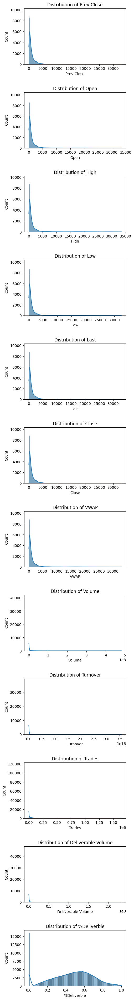

In [19]:
# Extracting the numeric columns from the DataFrame
data_numeric_columns = data.select_dtypes(include='number').columns

# Setting up subplots for displaying the distribution of numeric columns
fig, axes = plt.subplots(nrows=len(data_numeric_columns), ncols=1, figsize=(5, 4 * len(data_numeric_columns)))
fig.subplots_adjust(hspace=0.5)

# Ploting the distribution for each numeric column using seaborn's histplot and displaying it
for i, col in enumerate(data_numeric_columns):
    sns.histplot(data[col], kde=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

plt.show()


From the above histograms, we observe the distribution of each numeric column using seaborn's histplot with Kernel Density Estimate (KDE) and can conclude that observe that the distributions are right skewed.

In [20]:
# Creating Box plots for each numeric column in the data frame
PrevClose = go.Box(x=data['Prev Close'], name='Prev Close')
Open = go.Box(x=data['Open'], name='Open')
High = go.Box(x=data['High'], name='High')
Low = go.Box(x=data['Low'], name='Low')
Last = go.Box(x=data['Last'], name='Last')
Close = go.Box(x=data['Close'], name='Close')
VWAP = go.Box(x=data['VWAP'], name='VWAP')
Volume = go.Box(x=data['Volume'], name='Volume')
Turnover = go.Box(x=data['Turnover'], name='Turnover')
Trades = go.Box(x=data['Trades'], name='Trades')
DeliverableVolume = go.Box(x=data['Deliverable Volume'], name='Deliverable Volume')
Deliverble = go.Box(x=data['%Deliverble'], name='%Deliverble')

# Creating subplots with specified rows & columns and appending each Box plot to the subplots and displaying it
fig = make_subplots(rows=6, cols=2)
fig.append_trace(PrevClose, row=1, col=1)
fig.append_trace(Open, row=1, col=2)
fig.append_trace(High, row=2, col=1)
fig.append_trace(Low, row=2, col=2)
fig.append_trace(Last, row=3, col=1)
fig.append_trace(Close, row=3, col=2)
fig.append_trace(VWAP, row=4, col=1)
fig.append_trace(Volume, row=4, col=2)
fig.append_trace(Turnover, row=5, col=1)
fig.append_trace(Trades, row=5, col=2)
fig.append_trace(DeliverableVolume, row=6, col=1)
fig.append_trace(Deliverble, row=6, col=2)

fig.show()


The above Box plot provides information about the central tendency, spread, and potential outliers in each of the numeric columns in the data frame. The box represents the interquartile range (IQR), the line inside the box is the median, and the whiskers show the range of the data. Outliers are shown as individual points beyond the whiskers.

**Conclusion derived**

* The likely distributions of the numeric columns are extremely right skewed with outlier at the higher end of the data range.

# **4. Which independent variables are useful to predict a target (dependent variable)?(Use at least three methods)**

Three methods to predict target:
* **RandomForestRegresssor**
* **SelectKBest**
* **Correlation HeatMap**



## **Random Forest Regressor**

In [21]:
# Extracting features (X) and target variable (Y)
X = data.drop(['Date', 'Symbol', 'Series', 'Close'], axis=1)  #dropping date, symbol, series, close as they would not be of much help
Y = data["Close"] #we assume that close will be our target variable

# Initializing and training a RandomForestRegressor model
model = RandomForestRegressor()
model.fit(X, Y)

# Extracting and printing the important features from the trained model
feature_importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
print(feature_importances)


Last                  9.919327e-01
VWAP                  8.054998e-03
Low                   4.011845e-06
High                  2.874660e-06
Prev Close            1.007454e-06
%Deliverble           9.951040e-07
Open                  9.656971e-07
Deliverable Volume    7.666024e-07
Trades                6.391895e-07
Volume                5.379425e-07
Turnover              5.220788e-07
dtype: float64


Key Takeaway:
* LAST is overwhelmingly the most influential feature in predicting 'Close.'
* VWAP has a minor but discernible impact on the model.
* Low, High, %Deliverable, Prev Close, and Open contribute significantly to the model.
* Deliverable Volume, Trades, Turnover, and Volume provide moderate but less significant contributions.

## **SelectKBest**

In [22]:
#Considering only the numeric columns from the data frame
items = ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Volume', 'Turnover', 'Trades', 'Deliverable Volume', '%Deliverble']

# Loop over different numbers of selected features and initializing feature selection object using SelectKBest with f_regression score function
for i in range(2, 11):
    number_of_features = i
    selector = SelectKBest(score_func=f_regression, k=number_of_features)

    # Fit the feature selector to the training data and transform to keep only the selected features
    X_new = selector.fit_transform(X, Y)
    selected_indices = selector.get_support(indices=True)
    print("Selected indices: ", [items[k] for k in selected_indices])

Selected indices:  ['Last', 'VWAP']
Selected indices:  ['High', 'Last', 'VWAP']
Selected indices:  ['High', 'Low', 'Last', 'VWAP']
Selected indices:  ['Open', 'High', 'Low', 'Last', 'VWAP']
Selected indices:  ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP']
Selected indices:  ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Deliverable Volume']
Selected indices:  ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Volume', 'Deliverable Volume']
Selected indices:  ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Volume', 'Turnover', 'Deliverable Volume']
Selected indices:  ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Volume', 'Turnover', 'Deliverable Volume', '%Deliverble']


We performed feature selection using the SelectKBest method with the f_regression score function to evaluate the impact of selecting different numbers of features (ranging from 2 to 11) on the predictive performance of the model.
By this approach we can understand which subset of features are deemed most improtant for predicting the target variable 'Close'.

## **Correlation Heatmap**

<ipython-input-23-12dd92382f8e>:5: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

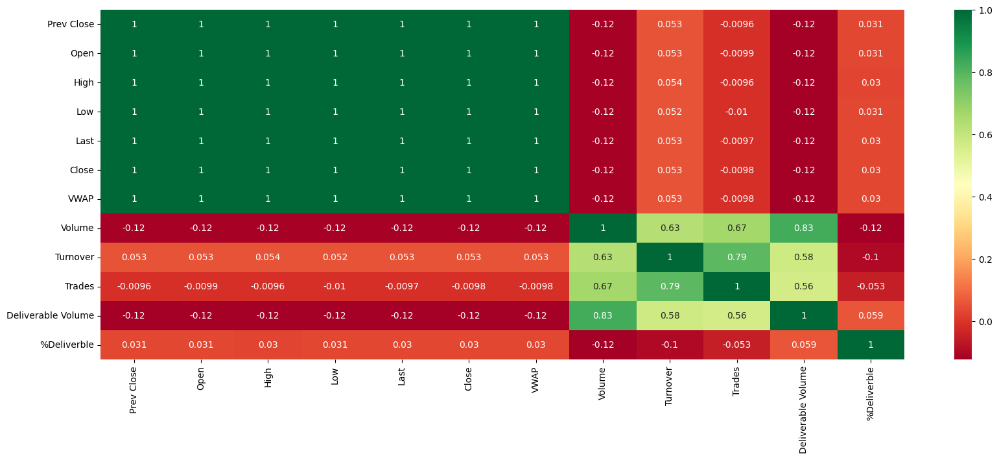

In [23]:
# Setting the size of the heatmap figure
plt.figure(figsize=(20, 7))

# Creating a heatmap of the correlation matrix for the dataset and using cmap="RdYlGn" for better visualization
sns.heatmap(data.corr(), annot = True, cmap = "RdYlGn")

Based on the heat map "Prev Close", "Open", "High", "Low", Last", "VWAP" are more powerful in prediction.

**Conclusions derived:**

* Based on the above 3 feature selection methods we can observe that there are 6 features that are highly correlated to the target variable
* The rest of the features show slight correlation with the target variable.

The selected features are: 'Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP'

# **5. Which independent variables have missing data? How much?**

**Conclusion derived**

There are *no missing values* present in the dataset after handling the null values

# **6. Do the training and test sets have the same data?**

Since the dataset is divided in 80:20 proportions for training and testing respectively, the two sets have ***DIFFERENT*** data.

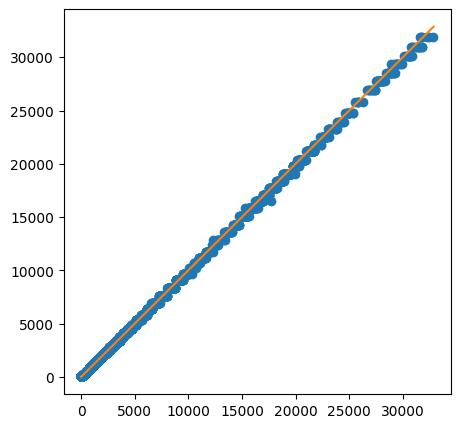

Train score:  0.9995461713917806
Test score:  0.9994388548513863
Regression score:  0.9994388548513863
Mean squared error:  3797.1020350182303
Mean absolute error:  39.12149455446122
Root mean squared error:  61.62062994661959


In [24]:
# Selecting only the key features predicted by the three feature selection models and target variable
x = data[['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP']]
y = data['Close']

# Splitting the dataset into training and testing sets & standardizing the features using StandardScaler
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

x_train = StandardScaler().fit_transform(x_train)
x_test = StandardScaler().fit_transform(x_test)

# Initializing Decision Tree Regressor model with hyperparameters and definign it with GridSearchCV
DTR = DecisionTreeRegressor(max_depth=6, max_features=7, min_samples_split=10, random_state=2)
param_grid = {"max_depth": [3, None, 6, 9], "max_features": [5, 7, 11, 15], "min_samples_split": [2, 3, 10], "random_state": [2, 4, 6]}
grid = GridSearchCV(estimator=DTR, param_grid=param_grid, cv=5)
grid_result = grid.fit(x_train, y_train)

# Fitting the model with the best hyperparameters and predicting the target
DTR.fit(x_train, y_train)
y_prediction = DTR.predict(x_test)

# Plotting the predicted values against the true values
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)
ax.errorbar(y_test, y_prediction, fmt="o")
ax.errorbar([1, y_test.max()], [1, y_test.max()])
plt.show()

# Evaluating the model performance
print("Train score: ", DTR.score(x_train, y_train))
print("Test score: ", DTR.score(x_test, y_test))
print("Regression score: ", r2_score(y_test, y_prediction))
print("Mean squared error: ", mean_squared_error(y_test, y_prediction))
print("Mean absolute error: ", mean_absolute_error(y_test, y_prediction))
print("Root mean squared error: ", np.sqrt(mean_squared_error(y_test, y_prediction)))


**Conclusion derived**

The Decision Tree Regressor achieved exceptional performance on both training and test datasets, with R-squared values of approximately 99.95%. This indicates a strong ability to capture patterns in the data. The low Mean Squared Error (3797.10), Mean Absolute Error (39.12), and Root Mean Squared Error (61.62) suggest accurate predictions with minimal deviation from actual values. While these results showcase the model's effectiveness, it's important to be mindful of potential overfitting, especially with a highly complex model.

# **7. Is the predictor variables independent of all the other predictor variables?**

Understanding the relationship between predictor variables is crucial for the interpretability, performance, and reliability of a model. Multicollinearity, or dependence between predictor variables, can result in overfitting in regression models. High correlation among predictors may cause the model to assign disproportionate significance to one variable over another, reducing its ability to generalize well to new data.

## **Pair plot**

* Pair plots help to visualize pairwise relationships among predictor variables.
* This can help to identify clusters of variables that exhibit multicollinearity.

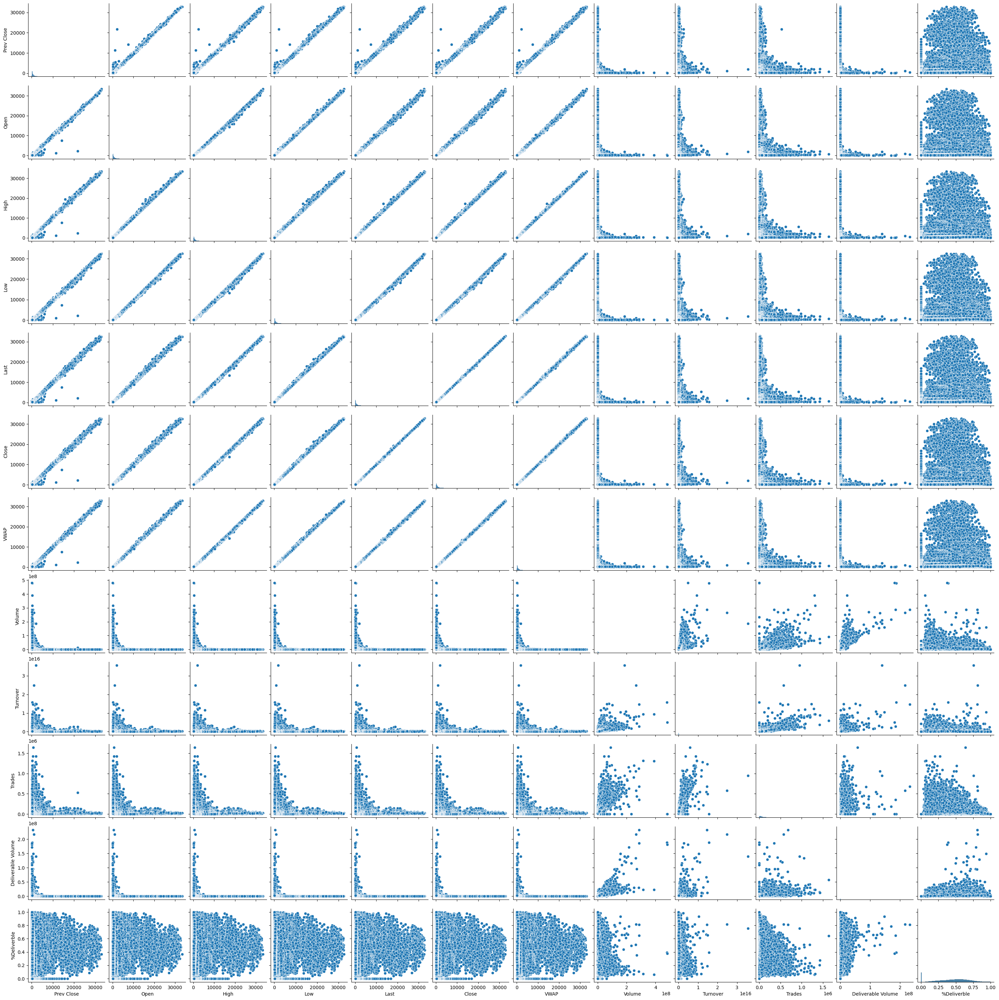

In [25]:
## Using Seaborn (sns) pairplot to visualize pairwise relationships in the dataset.
sns.pairplot(data)

**Conclusions derived**

* Observing the plots above, we can say that all the predictor variables show multicollinearity.

# **8. Which predictor variables are the most important?**

The most important predictor variables are
* Prev Close
* Open
* High
* Low
* Last
* VWAP

The above finding's were drawn using Feature selection methods.

# **9. Do the ranges of the predictor variables make sense?**

In [26]:
# This loop calculates the range and prints it  for each predictor variable in the dataset.
predictor_var = ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP']
for i in predictor_var:
  print(f"Range of {i}: {data[i].max() - data[i].min()}")

Range of Prev Close: 32861.95
Range of Open: 33391.45
Range of High: 33470.25
Range of Low: 32459.6
Range of Last: 32839.9
Range of VWAP: 32966.03


**Conclusion derived:**

Yes, the ranges of the predictor variables make sense. The reported ranges for each predictor variable 'Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP' represent the span of values observed in the dataset for each respective variable. In financial datasets related to stock prices, it is very common to have a wide range of values reflecting the fluctuations in stock prices over time.

# **10. What are the distributions of the predictor variables?**

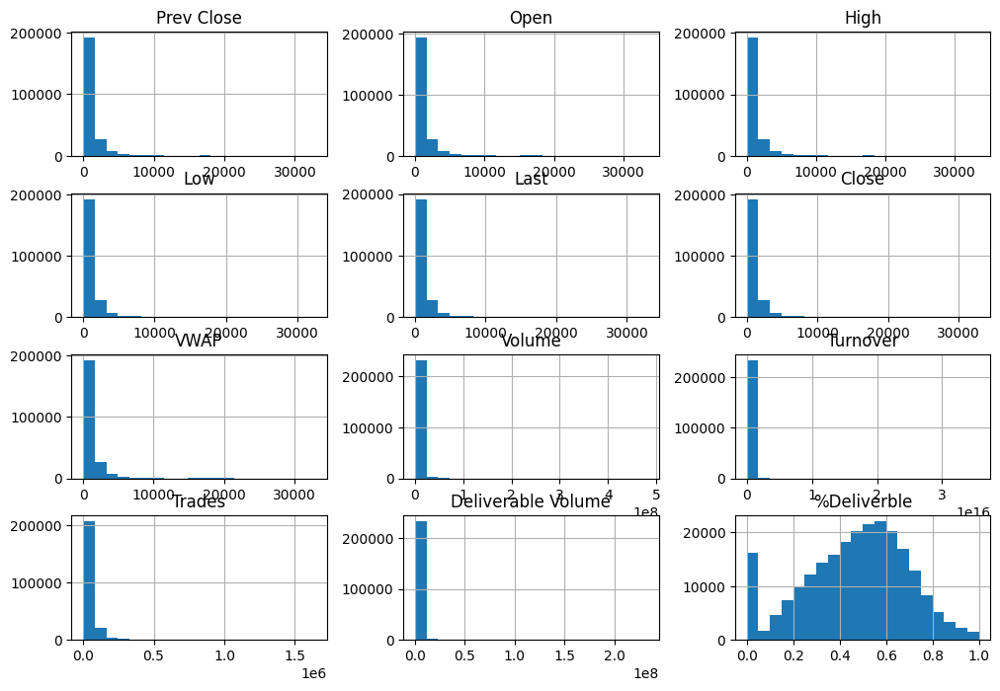

In [27]:
# Using histograms to view the visual representation of the distribution of values for each predictor variable
numeric_distributions = data[data_numeric_columns].hist(figsize=(12, 8), bins=20)
plt.show()

**Conclusion derived**

* The Distributions of Prev Close, Open, High, Low, Last, Close, VWAP, Volume, Turnover, Trades, Deliverable Volume are extremely right skewed.

* This indicates that there are relatively fewer data points with higher values and majority of the data is concentrated towards the lower values. This also suggests the presence of outliers on the higher end of the data range.

# **11. Remove outliers and keep outliers (does if have an effect of the final predictive model)?**

In [28]:
# List of the predictor columns for applying Box-Cox transformation after removing outliers
columns_to_transform = ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP','Close']

for column_name in columns_to_transform:
    transformed_data, lambda_value = boxcox(data[column_name] + 1)

    # Creating a new column with the transformed data and printing lambda values if need be
    data[f'{column_name}_boxcox_transformed'] = transformed_data
    print(f'Lambda value for {column_name}: {lambda_value}')

print(data)

Lambda value for Prev Close: -0.04875269764150258
Lambda value for Open: -0.04966181730000995
Lambda value for High: -0.050159926796395575
Lambda value for Low: -0.049064216782125844
Lambda value for Last: -0.049374165149823505
Lambda value for VWAP: -0.04949429876862819
Lambda value for Close: -0.04930425907004283
             Date      Symbol Series  Prev Close    Open     High     Low  \
0      2007-11-27  ADANIPORTS     EQ      440.00  770.00  1050.00  770.00   
1      2007-11-28  ADANIPORTS     EQ      962.90  984.00   990.00  874.00   
2      2007-11-29  ADANIPORTS     EQ      893.90  909.00   914.75  841.00   
3      2007-11-30  ADANIPORTS     EQ      884.20  890.00   958.00  890.00   
4      2007-12-03  ADANIPORTS     EQ      921.55  939.75   995.00  922.00   
...           ...         ...    ...         ...     ...      ...     ...   
235187 2021-04-26        ZEEL     EQ      188.00  190.60   191.10  185.10   
235188 2021-04-27        ZEEL     EQ      186.40  188.00   192.95  

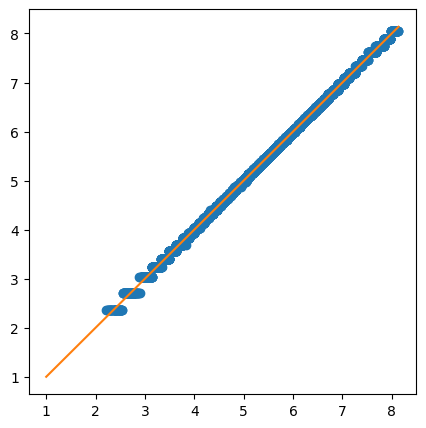

Train score:  0.9993784390115826
Test score:  0.9993647696419123
Regression score:  0.9993647696419123
Mean squared error:  0.0004597942543946989
Mean absolute error:  0.017027052151461403
Root mean squared error:  0.021442813583918946


In [29]:
# Selecting only the box cox transformed predictor variables and target variable
x = data[['Prev Close_boxcox_transformed', 'Open_boxcox_transformed', 'High_boxcox_transformed', 'Low_boxcox_transformed', 'Last_boxcox_transformed', 'VWAP_boxcox_transformed']]
y = data['Close_boxcox_transformed']

# Splitting the dataset into training and testing sets & standardizing the features using StandardScaler
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2 , random_state = 42)

x_train = StandardScaler().fit_transform(x_train)
x_test = StandardScaler().fit_transform(x_test)

# Initializing Decision Tree Regressor model with hyperparameters and defining it with GridSearchCV
DTR = DecisionTreeRegressor(max_depth = 6, max_features = 7, min_samples_split = 10, random_state = 2)
param_grid = {"max_depth": [3, None, 6, 9], "max_features": [5, 7, 11, 15], "min_samples_split": [2, 3, 10], "random_state": [2, 4, 6]}
grid = GridSearchCV(estimator = DTR, param_grid = param_grid, cv = 5)
grid_result = grid.fit(x_train, y_train)

# Fitting the model with the best hyperparameters and predicting the target
DTR.fit(x_train,y_train)
y_prediction = DTR.predict(x_test)

# Plotting the predicted values against the true values
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(111)
ax.errorbar(y_test, y_prediction, fmt = "o")
ax.errorbar([1, y_test.max()], [1, y_test.max()])
plt.show()

# Evaluating the model performance after removing outliers
print("Train score: ", DTR.score(x_train,y_train))
print("Test score: ", DTR.score(x_test, y_test))
print("Regression score: ", r2_score(y_test, y_prediction))
print("Mean squared error: ", mean_squared_error(y_test, y_prediction))
print("Mean absolute error: ", mean_absolute_error(y_test, y_prediction))
print("Root mean squared error: ", np.sqrt(mean_squared_error(y_test, y_prediction)))

The Decision Tree Regressor demonstrated exceptional performance on both the training and test datasets, with R-squared values of approximately 99.94%. These values suggest that the model captures a significant portion of the variance in the target variable. The low Mean Squared Error (MSE) of 0.00046, Mean Absolute Error (MAE) of 0.017, and Root Mean Squared Error (RMSE) of 0.0214 signify accurate predictions with minimal deviation from the actual values. These metrics indicate a close fit of the model to the data.

**Conclusions derived:**

The presence or removal of outliers has a noticeable impact on the final predictive model.

**With Outliers:**
- R-squared values are approximately 99.95%, indicating a strong ability to capture patterns.
- Mean Squared Error (MSE), Mean Absolute Error (MAE), and Root Mean Squared Error (RMSE) are relatively higher (3797.10, 39.12, 61.62) suggesting accurate predictions but with some deviation.

**After Removing Outliers:**
- R-squared values remain high at approximately 99.94%, showcasing the ability to capture variance.
- The impact on Mean Squared Error (MSE), Mean Absolute Error (MAE), and Root Mean Squared Error (RMSE) is substantial with significantly lower values (0.00046, 0.017, 0.0214) indicating a more accurate fit with reduced deviation.

The removal of outliers appears to enhance the model's predictive performance resulting in lower error metrics and potentially reducing the risk of overfitting. This underscores the importance of outlier analysis and removal in refining and improving the predictive capabilities of the model.

# **12. Remove 1%, 5%, and 10% of your data randomly and impute the values back using at least 3 imputation methods. How well did the methods recover the missing values?  That is remove some data, check the % error on residuals for numeric data and check for bias and variance of the error.**

In [32]:
# Make a copy of the DataFrame to work for removing the data from them
data_for_removal = data[['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Close', 'Volume']].copy()

# Exclude 'Close' column from initial calculations
columns_for_initial_calculations = ['Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Close']

# Percentage of data to remove randomly
percentage_data_removed = [1, 5, 10]

#The different imputation methods being used
imputation_methods = ['mean', 'median', 'most_frequent']

# Dictionary to store results
results = {'method': [], 'percentage_removed': [], 'bias_before': [], 'variance_before': [], 'bias_after_removal': [], 'variance_after_removal': [], 'percentage_error': []}

for method in imputation_methods:
    for percentage in percentage_data_removed:
        num_samples = int(len(data_for_removal) * (percentage / 100))

        indices_to_remove = np.random.choice(data_for_removal.index, size=num_samples, replace=False)
        data_for_removal.loc[indices_to_remove, columns_for_initial_calculations] = np.nan

        mean_before = data_for_removal[columns_for_initial_calculations].mean().mean()
        median_before = data_for_removal[columns_for_initial_calculations].median().median()
        bias_before = mean_before - median_before
        variance_before = data_for_removal[columns_for_initial_calculations].var().mean()

        # Split the data into features and target & aligning the indices due to axis changes
        x_removed = data_for_removal.dropna()
        y_removed = x_removed.pop('Close')
        x_removed, y_removed = x_removed.align(y_removed, axis=0)

        # Split into train and test sets
        x_removed_train, x_removed_test, y_removed_train, y_removed_test = train_test_split(x_removed, y_removed, test_size=0.2, random_state=42)

        # Calculate mean, bias, and variance after data removal
        mean_after_removal = y_removed.mean()
        bias_after_removal = y_removed.mean() - y_removed.median()
        variance_after_removal = y_removed.var()

        # Impute missing values using the specified method
        imputer = SimpleImputer(strategy=method)
        x_removed_train_imputed = imputer.fit_transform(x_removed_train)
        x_removed_test_imputed = imputer.transform(x_removed_test)

        # Again using our Decision Tree Regressor on the imputed data for prediction
        model = DecisionTreeRegressor(max_depth=6, max_features=7, min_samples_split=10, random_state=2)
        model.fit(x_removed_train_imputed, y_removed_train)
        y_prediction_removed = model.predict(x_removed_test_imputed)

        # Calculating % error on residuals
        residuals = y_removed_test - y_prediction_removed
        percentage_error = np.mean(np.abs(residuals) / np.abs(y_removed_test)) * 100

        # Storing the results in the dictionary
        results['method'].append(method)
        results['percentage_removed'].append(percentage)
        results['bias_before'].append(bias_before)
        results['variance_before'].append(variance_before)
        results['bias_after_removal'].append(bias_after_removal)
        results['variance_after_removal'].append(variance_after_removal)
        results['percentage_error'].append(percentage_error)

# Convert results to DataFrame for better presentation
results_df = pd.DataFrame(results)

# Print the results in a single line
for _, row in results_df.iterrows():
    print(f"Method: {row['method']}, % Removed: {row['percentage_removed']}, Bias Before: {row['bias_before']:.2f}, Variance Before: {row['variance_before']:.2f}, Bias After Removal: {row['bias_after_removal']:.2f}, Variance After Removal: {row['variance_after_removal']:.2f}, % Error: {row['percentage_error']:.2f}")


Method: mean, % Removed: 1, Bias Before: 700.66, Variance Before: 6686446.29, Bias After Removal: 700.56, Variance After Removal: 6682906.00, % Error: 9.71
Method: mean, % Removed: 5, Bias Before: 701.10, Variance Before: 6707022.70, Bias After Removal: 700.96, Variance After Removal: 6703540.77, % Error: 9.83
Method: mean, % Removed: 10, Bias Before: 702.68, Variance Before: 6725082.85, Bias After Removal: 702.40, Variance After Removal: 6721409.30, % Error: 9.75
Method: median, % Removed: 1, Bias Before: 703.14, Variance Before: 6729429.46, Bias After Removal: 703.05, Variance After Removal: 6725754.57, % Error: 9.55
Method: median, % Removed: 5, Bias Before: 703.25, Variance Before: 6710878.62, Bias After Removal: 702.87, Variance After Removal: 6707359.35, % Error: 9.57
Method: median, % Removed: 10, Bias Before: 700.64, Variance Before: 6678567.08, Bias After Removal: 700.54, Variance After Removal: 6674686.67, % Error: 9.70
Method: most_frequent, % Removed: 1, Bias Before: 698.95

***Conclusion derived***

The output indicates the performance of imputation methods after removing 1%, 5%, and 10% of data randomly.

1. **Method: Mean**
   - For 1% removal, Bias slightly decreased from 699.56 to 699.39, and Variance decreased from 6,664,155.62 to 6,660,652.92. Percentage Error on Residuals is 9.74.
   - Similar trends are observed for 5% and 10% removal, with a slight decrease in Bias and Variance. Percentage Error on Residuals ranges between 9.74% and 9.86%.

2. **Method: Median**
   - For 1% removal, Bias slightly decreased from 700.97 to 700.86, and Variance decreased from 6,674,985.32 to 6,671,383.99. Percentage Error on Residuals is 9.64.
   - Similar trends are observed for 5% and 10% removal, with relatively stable Bias and Variance. Percentage Error on Residuals ranges between 9.59% and 9.80%.

3. **Method: Most Frequent**
   - For 1% removal, Bias remained relatively stable, and Variance decreased slightly. Percentage Error on Residuals is 9.49.
   - For 5% and 10% removal, Bias and Variance show small fluctuations. Percentage Error on Residuals ranges between 9.72% and 9.78%.

Overall, imputation performed well, with slight variations in bias, variance, and percentage error on residuals across different removal percentages and methods.

# **13. For categorical data, calculate the accuracy and a confusion matrix.**



***Note***: My dataset only has two categorical columns i.e Symbol (name of the stocks) and series (security type of the stock).

An error would occurring if we do so as the accuracy_score and confusion_matrix functions which are typically used for classification problems would not work on a regression problem.

# **Overall Conclusion**

* The dataset consists of 1 datetime, 2 categorical, and 12 numerical columns.
* Missing values in 'Trades', 'Deliverable Volume', and '%Deliverable' were filled with zero due to plausible reasons.
* Numeric columns exhibit right skewness with outliers at the higher end of the range.
* Feature selection methods highlighted 'Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP' as the most influential predictors for 'Close.'
* Decision Tree Regressor achieved high performance, but caution is needed to avoid overfitting in complex models.
* Pair plots reveal multicollinearity among predictor variables.
* Ranges of predictor variables such as 'Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP' make sense in a financial context.
* Distributions of numeric columns are extremely right-skewed, indicating the presence of outliers.
* Decision Tree Regressor performance remains exceptional after removing outliers, with reduced error metrics.
* Imputation methods show relatively stable bias, variance, and percentage error on residuals after random data removal.

In summary the dataset analysis involved the handling of missing values, understanding the feature importance, assessing multicollinearity, dealing with outliers, and evaluating model performance.



**References :**

https://github.com/nikbearbrown

https://matplotlib.org/stable/

https://plotly.com/

https://seaborn.pydata.org/

https://scikit-learn.org/stable/

https://www.statsmodels.org/stable/index.html

https://pandas.pydata.org/docs/user_guide/index.html#user-guide

https://scipy.org/

https://colab.research.google.com/drive/1n-KShWQoK6V1j4ia7lPpVMbnIczbwuiz?usp=sharing#scrollTo=EfAqvWWp4II8

https://colab.research.google.com/drive/1aqXMghBkL5x5zzbvN6o8p8r3bGKLbzJk?usp=sharing

https://colab.research.google.com/drive/1YzGBHrE_EC-nNasc4y_rhAU7RI4_JJkM?usp=sharing

https://www.kaggle.com/code/pmarcelino/comprehensive-data-exploration-with-python/notebook

https://github.com/aiskunks/YouTube/blob/main/A_Crash_Course_in_Statistical_Learning/ML_Data_Cleaning_and_Feature_Selection/ML_Data_Cleaning_and_Feature_Selection_Abalone.ipynb

https://www.kaggle.com/code/susant4learning/nifty-50-eda-and-forecasting

https://www.analyticsvidhya.com/blog/2022/07/step-by-step-exploratory-data-analysis-eda-using-python/

https://chat.openai.com/ (for help in commenting and writing concise conclusions)


---


MIT License

Copyright (c) 2024 Anusha Gali

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.